# <div align='center'><i>Visualizing CNN's</i></div>

<div align='center'>Here I shall use the Cats Vs Dogs trained model to demonstrate the different techniques to visualise what the CNN has learned. </div>

In [29]:
import cv2
import numpy as np
from keras import models
from keras import backend as K
import matplotlib.pyplot as plt
from keras.models import load_model
from keras.preprocessing import image

#### Load Model

![model](./Images/Model.png)

In [4]:
# Load the Trained Model
TModel = load_model('cats_and_dogs_small_v2.h5')
TModel.summary()

Model: "sequential_4"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_12 (Conv2D)           (None, 148, 148, 32)      896       
_________________________________________________________________
conv2d_13 (Conv2D)           (None, 146, 146, 32)      9248      
_________________________________________________________________
max_pooling2d_12 (MaxPooling (None, 73, 73, 32)        0         
_________________________________________________________________
conv2d_14 (Conv2D)           (None, 71, 71, 64)        18496     
_________________________________________________________________
conv2d_15 (Conv2D)           (None, 69, 69, 64)        36928     
_________________________________________________________________
dropout_3 (Dropout)          (None, 69, 69, 64)        0         
_________________________________________________________________
max_pooling2d_13 (MaxPooling (None, 34, 34, 64)       

#### Load Image

In [96]:
# Load a random image that the Model wasn't trained on
def LoadIMG(img_path):
    img = image.load_img(img_path,target_size=(150,150))
    
    # Preprocess the image as it was done for training the Model
    img_tensor = image.img_to_array(img)
    img_tensor = np.expand_dims(img_tensor, axis=0) #adding the batch_size
    img_tensor /= 255.
    
    return img_tensor

### Method-1: <i>Visualizing Intermediate Activations</i>

List of the Layers in the Model:


List of the Required Layers in the Model:



/home/lordgrim/.local/lib/python3.7/site-packages/ipykernel_launcher.py:60: RuntimeWarning: invalid value encountered in true_divide


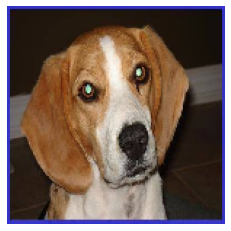

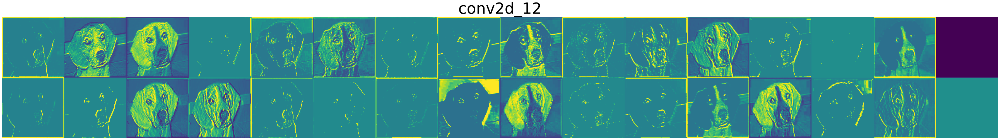

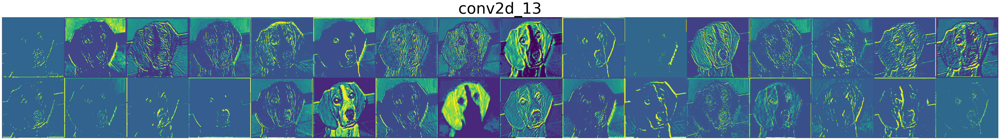

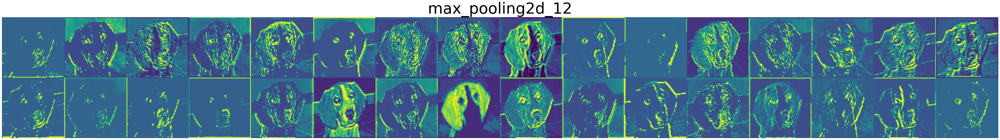

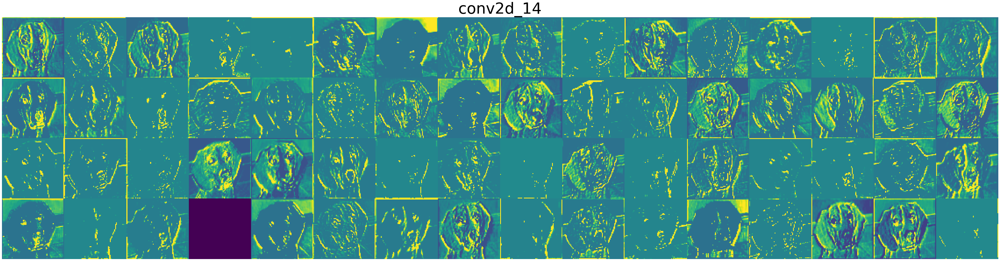

...

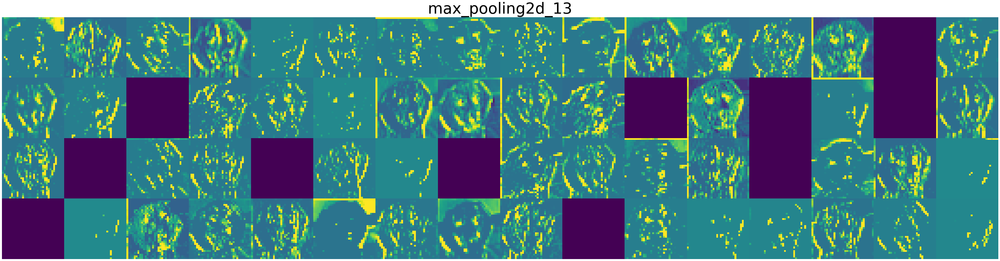

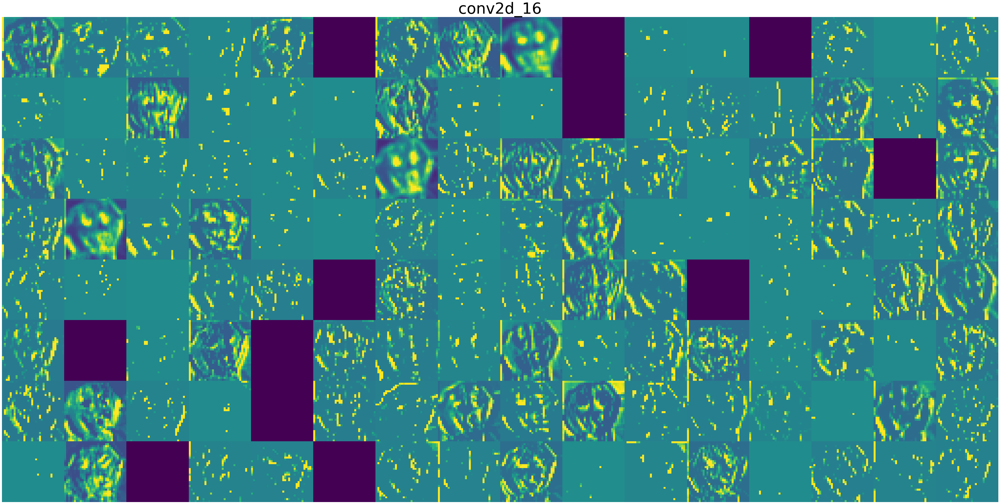

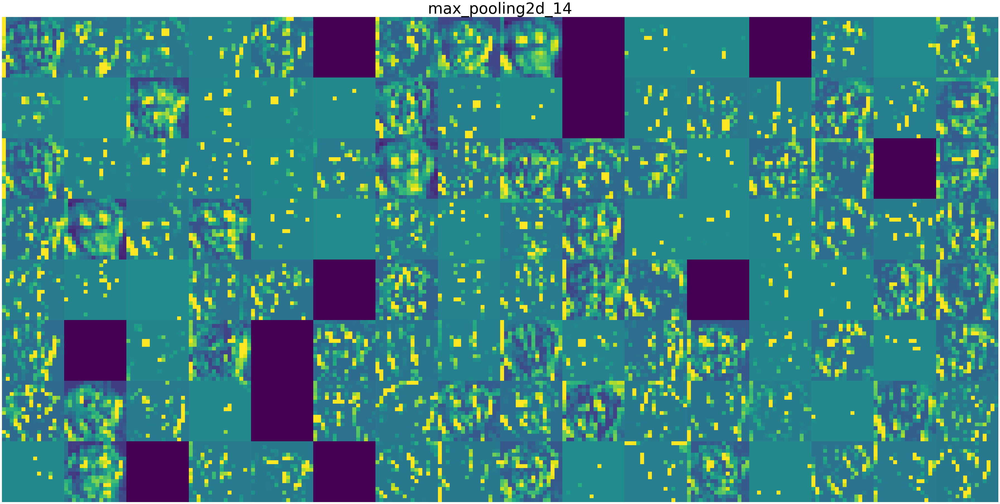

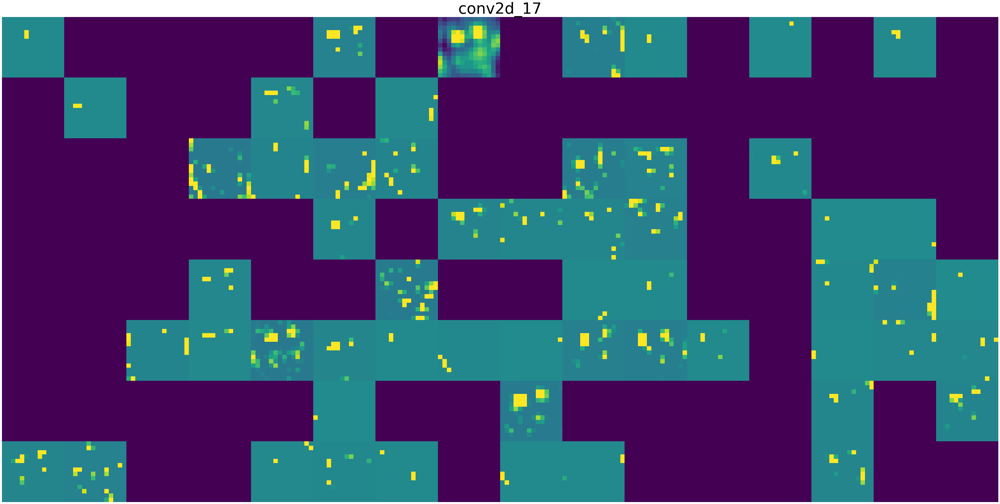

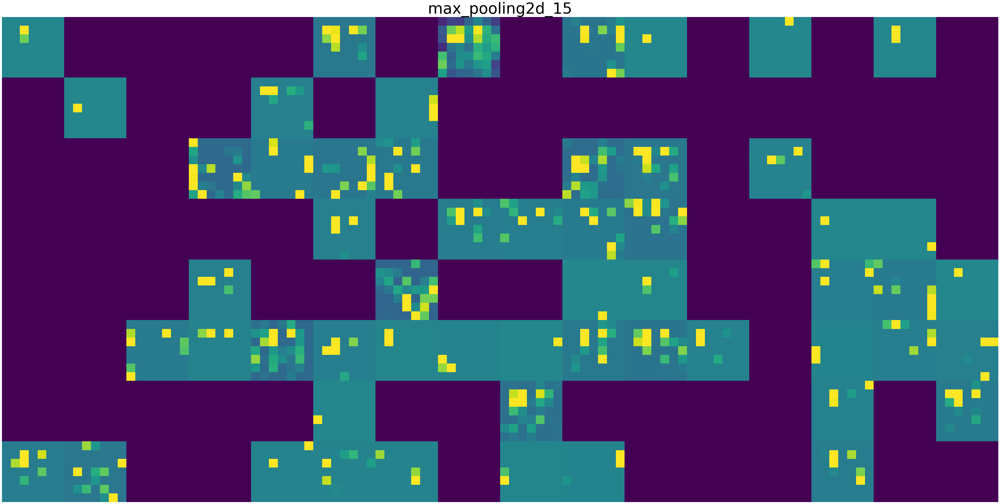

In [94]:
# List of all the different layers in the model
print("List of the Layers in the Model:\n")
for layer in TModel.layers:
    print(layer)
    
# Indices of the layers we want
Indices = [0,1,2,3,4,6,7,9,10,12]

# List to store the Required layers
Required_Layers = []
for i,idx in enumerate(Indices):
    Required_Layers.append(TModel.layers[idx])
    
# Displaying the layers we have selected
print("\nList of the Required Layers in the Model:\n")
for layer in Required_Layers:
    print(layer)

# Image tensor
img_tensor = LoadIMG('./Images//435.jpg')

# Plot the image
plt.imshow(img_tensor[0])
plt.axis('off')

# Define a List to rename these Layers as per the Model Summery
Layers_names = ['conv2d_12',
                'conv2d_13',
                'max_pooling2d_12',
                'conv2d_14',
                'conv2d_15',
                'max_pooling2d_13',
                'conv2d_16',
                'max_pooling2d_14',
                'conv2d_17',
                'max_pooling2d_15']
    
Each_Layer_Output = [Layer.output for Layer in Required_Layers]

"""Creates a Model that will return each layer outputs, given an input"""
Activation_model = models.Model(inputs=TModel.input, outputs=Each_Layer_Output)

# Get the output of each layer
Output = Activation_model.predict(img_tensor)

# Displaying the Feature maps of each selected layer
images_per_row = 16

for Lname, Loutput in zip(Layers_names, Output):
    
    # The feature map has shape (1, size, size, n_features)
    # Number of features in the feature map
    n_features = Loutput.shape[-1]
    
    size = Loutput.shape[1]
    
    n_rows = n_features// images_per_row
    display_grid = np.zeros((size * n_rows, images_per_row * size))
    for row in range(n_rows):
        for col in range(images_per_row):
            channel_image = Loutput[0,:, :,row * images_per_row + col]
            channel_image -= channel_image.mean()
            channel_image /= channel_image.std()
            channel_image *= 64
            channel_image += 128
            channel_image = np.clip(channel_image, 0, 255).astype('uint8')
            display_grid[row * size : (row + 1) * size,col * size : (col + 1) * size] = channel_image
            
    scale = 4. / size
    plt.figure(figsize=(scale * display_grid.shape[1],scale * display_grid.shape[0]))
    plt.axis('off')
    plt.title(Lname,fontsize=55)
    plt.grid(False)
    plt.imshow(display_grid, aspect='auto')

<div align='center'> <b>From the above visualization we can see that in the initial few layers, all filters are activated by the input image; but in the following layers, more and more filters are blank. This means the pattern encoded by the filter isn’t found in the input image.</b></div>

### Method-2: <i>Visualizing Convnet Filters</i>

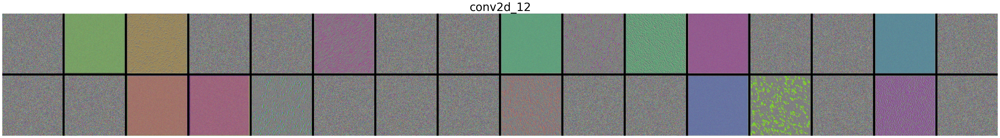

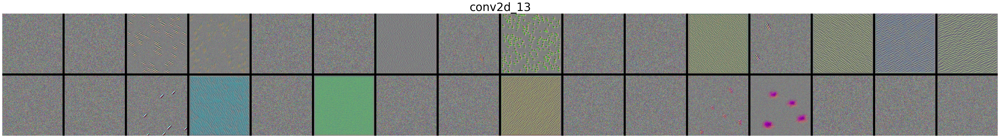

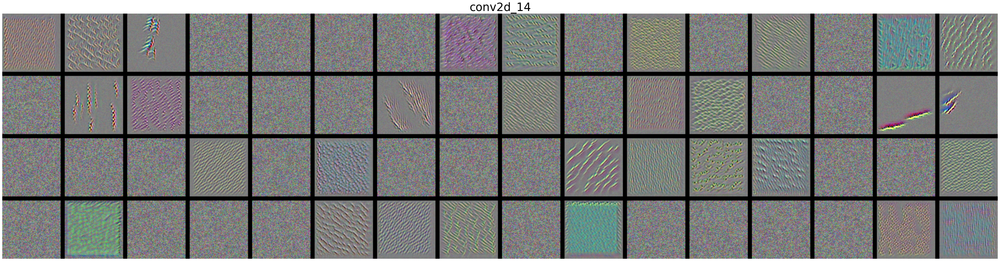

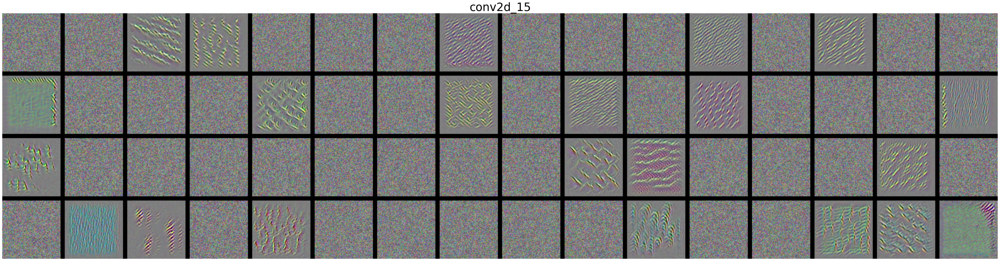

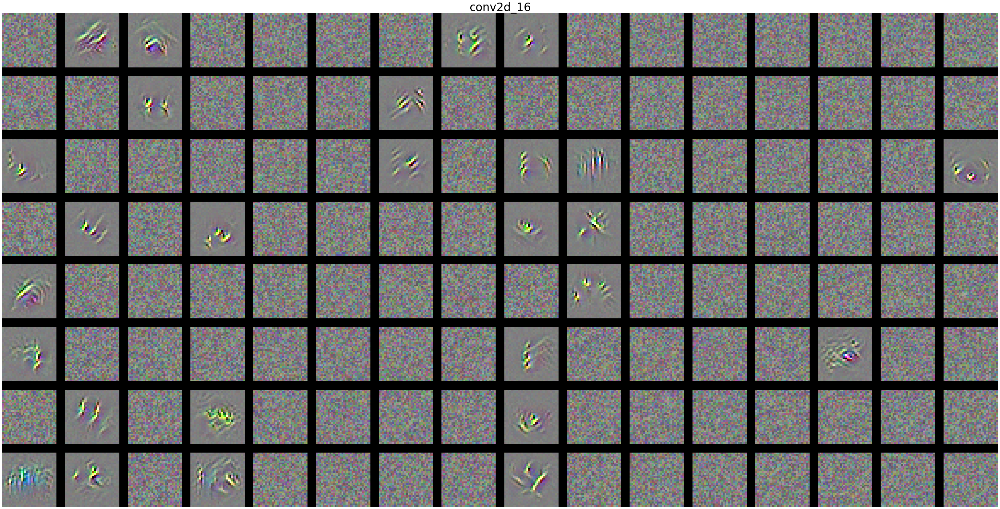

In [34]:
# Indices of the layers we want
Indices = [0,1,3,4,7]

Layers_names = ['conv2d_12',
                'conv2d_13',
                'conv2d_14',
                'conv2d_15',
                'conv2d_16']

# List to store the Required layers
Required_Layers = []
for i,idx in enumerate(Indices):
    Required_Layers.append(TModel.layers[idx])

#function to convert a tensor into a image
def deprocess_image(x):
   
    '''Normalizes the tensor, center on 0, ensures
                and that std is 0.1'''
    
    x -= x.mean()
    x /= (x.std() + 1e-5)
    x *= 0.1
    x += 0.5
    x = np.clip(x, 0, 1)
    x *= 255
    x = np.clip(x, 0, 255).astype('uint8')
    
    return x

# Function to generate filter visualizations
def generate_pattern(layer_idx, filter_index, size=150):
    
    layer_output = TModel.layers[layer_idx].output
    """loss function that maximizes the activation of the 
            nth filter of the layer under consideration"""
    loss = K.mean(layer_output[:, :, :, filter_index])
    
    """Computes the gradient of the 
    input picture with regard to this loss"""
    # Returns a list of tensors (of size 1 in this case).Hence,you keep only the first element
    grads = K.gradients(loss, TModel.input)[0] 
    
    """Gradient-normalization trick to help the gradient-descent process go smoothly """
    grads /= (K.sqrt(K.mean(K.square(grads))) + 1e-5)
    
    # Returns the loss and grads given the input picture
    iterate = K.function([TModel.input], [loss, grads])
    
    # Starts from a gray image with some noise
    input_img_data = np.random.random((1, size, size, 3)) * 20 + 128.
    
    # Gradient ascent
    step = 1.
    for i in range(40):
        loss_value, grads_value = iterate([input_img_data])
        # Update the image
        input_img_data += grads_value * step
    
    img = input_img_data[0]
    return deprocess_image(img)

# Generating a grid of all filter response patterns in a layer
images_per_row = 16
margin = 5

for Lname, Lidx in zip(Layers_names, Indices):
    # Number of filters in the given layer
    n_features = TModel.layers[Lidx].output.shape[-1]
    
    # Dimention of each filter
    size = TModel.layers[Lidx].output.shape[1]
    
    n_rows = n_features// images_per_row
    
    display_grid = np.zeros((size * n_rows + (n_rows-1)*margin, images_per_row * size+ (images_per_row-1)*margin,3))
    
    for row in range(n_rows):
        for col in range(images_per_row):
            Fidx = row * images_per_row + col
            H_Start = row * size + row * margin
            H_End = H_Start + size
            V_Start = col* size + col*margin 
            V_End = V_Start + size
            display_grid[H_Start : H_End, V_Start : V_End,:] = generate_pattern(Lidx,Fidx,size) 
    
    plt.figure(figsize=(55,55))
    plt.axis('off')
    plt.title(Lname,fontsize=35)
    plt.grid(False)
    plt.imshow(display_grid.astype(np.uint8))

<div align='center'><b>From the above visualization we can see that the filters from the first layer in the model encode simple directional edges and colors while the filters in higher layers begin to resemble textures found in natural images:eyes, ears, nose etc.</b></div>

### Method-3: <i>Visualizing HeatMaps</i>

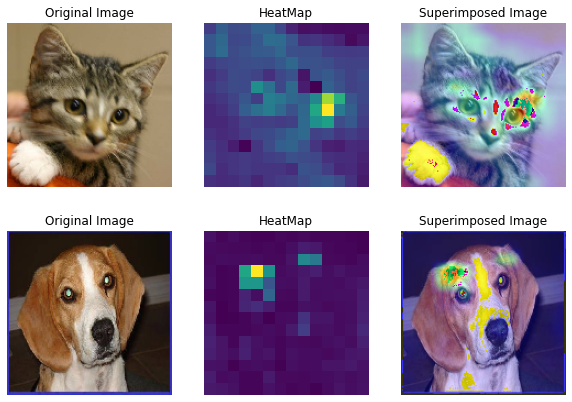

In [97]:
def GCAM(img_tensor):
    
    """ Since we have only one output neuron in our model as I am using a sigmoid fn 
    we can do as I have done below but if we had more than one output neurons then
    we need to take only the outpout of the neuron which the model is predicting it as""" 

    output = TModel.output

    # The last convolutional layer in the Model
    last_conv_layer = TModel.layers[10]

    # Gradient of the respective class with regard to the output feature map of conv2d_17
    grads = K.gradients(output, last_conv_layer.output)[0]

    """Vector of shape (depth of the layer,), where each entry is 
    the mean intensity of the gradient over a specific feature-map channel"""
    pooled_grads = K.mean(grads, axis=(0, 1, 2))

    iterate = K.function([TModel.input],[pooled_grads, last_conv_layer.output[0]])

    #Values of these two quantities, as Numpy arrays, given the sample image
    pooled_grads_value, conv_layer_output_value = iterate([img_tensor])

    """Multiplies each channel in the feature-map array by 
    “how important this channel is” with regard to the “Dog” class"""
    for i in range(128):
        conv_layer_output_value[:, :, i] *= pooled_grads_value[i]

    # The channel-wise mean of the resulting feature map is the heatmap of the class activation.
    heatmap = np.mean(conv_layer_output_value, axis=-1)

    #Heatmap post-processing
    heatmap = np.maximum(heatmap, 0)
    heatmap /= np.max(heatmap)
    
    return(heatmap)

def SuperImpose(img_path, heatmap):
    
    # Using OpenCV to superimpose the image
    img = cv2.imread(img_path)
    
    shape = LoadIMG(img_path).shape[1]
    
    #Resizing the image and heatmap to the same size as image tensor
    img = cv2.resize(img, (shape, shape))
    heatmap = cv2.resize(heatmap, (img.shape[1], img.shape[0]))
    
    heatmap = np.uint8(255 * heatmap)
    
    heatmap = cv2.applyColorMap(heatmap, cv2.COLORMAP_JET)
    
    superimposed_img = heatmap * 0.4 + img
    
    """OpenCv take images in BGR fromat so we need to covert it to
                RGB befor desplaying it with matplotlib"""
    b,g,r = cv2.split(superimposed_img)
    rgb_img = cv2.merge([r,g,b]) 
    
    return(rgb_img.astype(np.uint8))

def Plot(img_path):
    
    fig, ax = plt.subplots(2, 3, figsize=(10,7))
    labels = ["Original Image","HeatMap","Superimposed Image"]
    
    Tensor = []
    Tensor.append(LoadIMG(img_path[0]))
    Tensor.append(LoadIMG(img_path[1]))
    
    for i in range(2):
        for j in range(1):
            
            ax[i,j].imshow(Tensor[i][0])
            ax[i,j].set_title(labels[j])
            ax[i,j].axis('off')
            
            ax[i,j+1].imshow(GCAM(Tensor[i]))
            ax[i,j+1].set_title(labels[j+1])
            ax[i,j+1].axis('off')
            
            ax[i,j+2].imshow(SuperImpose(img_path[i],GCAM(Tensor[i])))
            ax[i,j+2].set_title(labels[j+2])
            ax[i,j+2].axis('off')
    
img_path = ['./Images/1.jpg','./Images/435.jpg']
Plot(img_path)

<div align='center'><b>The highlighted parts of the above superimposed images helps us in understanding which parts of a given image led a convnet to its final classification decision. This is helpful for debugging the decision process of a convnet, particularly in the case of a classification mistake. It also allows you to locate specific objects in an image.</b></div>